### Imports

In [1]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
from PIL import Image
import cv2
import os
from os import listdir

from skimage import data
from skimage import transform
from scipy.ndimage import binary_fill_holes
from skimage import img_as_ubyte
from skimage.color import rgb2gray, rgb2hsv
from skimage.exposure import equalize_hist, histogram, adjust_sigmoid
from skimage.feature import canny
from skimage.filters import threshold_otsu, unsharp_mask, gaussian, median
from skimage.measure import find_contours, approximate_polygon
from skimage.morphology import (dilation, erosion, binary_closing, binary_opening,
                                remove_small_objects, thin, convex_hull_image, square, disk, diamond, star)
from skimage.segmentation import clear_border
from skimage.util import invert

from tqdm import tqdm
from numpy import random as rnd

### Additional functions:

In [2]:
def to_uint8(img):
    return (img * 255).astype(np.uint8)

In [3]:
def to_1ch(img, mode='gray'):
    transf_1ch = (
        {'r': lambda img: img[:, :, 0],
         'g': lambda img: img[:, :, 1],
         'b': lambda img: img[:, :, 2],
         'h': lambda img: img_as_ubyte(rgb2hsv(img)[:, :, 0]),
         's': lambda img: img_as_ubyte(rgb2hsv(img)[:, :, 1]),
         'v': lambda img: img_as_ubyte(rgb2hsv(img)[:, :, 2]),
         'gray': lambda img: img_as_ubyte(rgb2gray(img))}
    )
    return transf_1ch[mode](img)

In [4]:
def to_bin(img, thr='otsu'):
    if thr == 'otsu':
        return img > threshold_otsu(img)
    else:
        return img > 255 * thr

In [5]:
def list_get(list_, ind_, default_):
  try:
    return list_[ind_]
  except IndexError:
    return default_

In [6]:
def set_padding(img, num, val):
    if num > 0:
        h, w = img.shape
        new_img = np.full((h + 2 * num, w + 2 * num), val)
        new_img[num:-num, num:-num] = img
        img = new_img.astype(img.dtype)
    elif num < 0:
        num = -num
        img = img[num:-num, num:-num]
    return img

In [7]:
def resize_prop(img, max_size):
    h, w = img.shape[:2]
    img_max_size = max(w, h)
    if max_size < img_max_size:
        ratio = img_max_size / max_size
        w, h = int(w / ratio), int(h / ratio)
        
        img = cv2.resize(img, (w, h),
                         interpolation=cv2.INTER_AREA)
    return img

In [8]:
def show_images(img_arr, name_arr=[], n_in_row=3, factor_r=4, factor_c=4, figsize=None,
         title=None, cmap_='Greys', label_fontsize=12, tick_fontsize=11, save_path=None):
    if type(img_arr) is np.ndarray:
        quant = img_arr.shape[0]
    elif type(img_arr) is list:
        quant = len(img_arr)
    cols = min(quant, n_in_row)
    rows = quant // n_in_row + (1 if quant % n_in_row else 0)
    if figsize is None:
        figsize = (int(factor_c * cols), int(factor_r * rows))
    fig = plt.figure(figsize=figsize)
    if title is not None:
        fig.suptitle(title, fontsize=14, y = 0.88)
    for i, img in enumerate(img_arr):
        ax = fig.add_subplot(rows, cols, i + 1)
        if type(img) is tuple:
            x, y = img
            ax.plot(x, y)
            ax.set_xlabel(list_get(name_arr, i, ''), fontsize=label_fontsize)
        else:
            ax.imshow(img, cmap=cmap_)
            ax.set_xlabel(list_get(name_arr, i, ''), fontsize=label_fontsize)
            ax.xaxis.set_major_locator(MaxNLocator(integer=True))
            ax.yaxis.set_major_locator(MaxNLocator(integer=True))
            ax.xaxis.set_ticks_position('top')
            ax.tick_params(axis='both', labelsize=tick_fontsize)
    plt.tight_layout()
    if save_path is not None:
        plt.savefig(f'{save_path}')
    plt.show()

In [9]:
def show_image_cv(img, name):
    img = cv2.cvtColor(img, cv2.COLOR_RGB2BGR)
    img = resize_prop(img, 700)
    cv2.imshow(name, img)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

### Functions

In [10]:
def get_paper_mask(img):
    paper = np.copy(img)
    paper = to_1ch(paper, mode='s')
    paper = invert(to_bin(paper))
    
    pad_val = 30
    
    paper = set_padding(paper, pad_val, False)
    paper = binary_fill_holes(paper, disk(1))
    paper = binary_closing(paper, disk(10))
    paper = remove_small_objects(paper, 10000)
    paper = set_padding(paper, -pad_val, False) > 0

    return paper

In [11]:
def color_mask(img, mask, color):
    img = np.copy(img)
    img[mask] = color
    return img

In [12]:
def get_bb_coords(points):
    bb_min = np.array([np.min(points[:, 0]), np.min(points[:, 1])])
    bb_max = np.array([np.max(points[:, 0]), np.max(points[:, 1])])
    return np.array([bb_min, [bb_min[0], bb_max[1]], bb_max, [bb_max[0], bb_min[1]]])

In [13]:
def get_paper_coords(paper_mask, iters=1):
    img = to_uint8(paper_mask)
    
    # contour
    contours, _ = cv2.findContours(img, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    contour = contours[0]
    
    # corners
    eps_ = 0.083 # it's mean of [0.002, 0.164]
    epsilon= eps_ * cv2.arcLength(contour, True)
    borders = cv2.approxPolyDP(contour, epsilon, True)
    n = len(borders)

    # epsilon search if not rectangle
    if n != 4:
        delta = 0.001
        if n < 4:
            delta = -delta
        n_old = n

        while n != 4:
            eps_ += delta
            epsilon= eps_ * cv2.arcLength(contour, True)
            borders = cv2.approxPolyDP(contour, epsilon, True)
            n = len(borders)

            if n_old < 4 and n > 4 or n_old > 4 and n < 4:
                delta = -delta / 10    
            n_old = n
            
    corners, contour = borders.reshape((4, 2)), contour.reshape(-1, 2)
    # corners sorting
    corners = np.array(sorted(corners, key = lambda x: x[0]**2 + x[1]**2))
    if corners[1, 0] > corners[2, 0]:
        corners[1], corners[2] = np.copy(corners[2]), np.copy(corners[1])
    corners[2], corners[3] = np.copy(corners[3]), np.copy(corners[2])
    res = []
    
    # loop by 4 borders
    for i in range(4):
        # border
        c1, c2 = corners[i], corners[(i + 1) % 4]
        side = 0
        if np.abs(c1[0] - c2[0]) < np.abs(c1[1] - c2[1]):
            side = 1
        i1 = np.where((contour[:,0] == c1[0]) & (contour[:,1] == c1[1]))[0][0]
        i2 = np.where((contour[:,0] == c2[0]) & (contour[:,1] == c2[1]))[0][0]
        if i1 < i2:
            contour_border = contour[i1: i2 + 1]
        else:
            contour_border = np.vstack([contour[i1:], contour[:i2]])
        contour_border = np.array(sorted(contour_border, key = lambda x: x[side]))
        contour_border_side = contour_border[:, side]
        
        # iterations on border
        
        arr = [c1, c2]
        for j in range(iters):
            arr_len = len(arr)
            new_arr = []
            for k in range(arr_len - 1):
                p1, p2 = arr[k], arr[k + 1]
                mid_side = np.mean([p1, p2], axis=0).astype(np.int)[side]

                mid_mask = (np.array(([True] + list(contour_border_side <= mid_side)))[:-1] *
                            (contour_border_side >= mid_side) +
                            np.array((list(contour_border_side >= mid_side) + [True]))[1:] *
                            (contour_border_side <= mid_side))

                points = contour_border[mid_mask]
                len_p = len(points)
                if len_p % 2:
                    mid = points[len_p // 2]
                else:
                    mid = np.array([0, 0])
                    mid[side] = mid_side
                    mid[1 - side] = np.mean([points[len_p // 2 - 1],
                                             points[len_p // 2]], axis=0).astype(np.int)[1 - side]
                new_arr += [p1, mid]
            new_arr += [arr[-1]]
            arr = new_arr
        res += arr[:-1]
    res = np.array(res)

    bb = get_bb_coords(res)
    res2 = []
    
    for i in range(4):
        # border
        arr = [bb[i], bb[(i + 1) % 4]]
        for j in range(iters):
            arr_len = len(arr)
            new_arr = []
            for k in range(arr_len - 1):
                p1, p2 = arr[k], arr[k + 1]
                mid = np.mean([p1, p2], axis=0).astype(np.int)
                new_arr += [p1, mid]
            new_arr += [arr[-1]]
            arr = new_arr
        res2 += arr[:-1]
    res2 = np.array(res2)
    
    return res, res2

In [14]:
def get_projected_paper(img, in_points, out_points, vis=False):
    out_points = np.copy(out_points)
    out_points[:, 0] -= min(out_points[:, 0])
    out_points[:, 1] -= min(out_points[:, 1])
    out_shape = (max(out_points[:, 0]), max(out_points[:, 1]))[::-1]

    tform3 = transform.ProjectiveTransform()
    tform3.estimate(out_points, in_points)
    res = transform.warp(img, tform3, output_shape=out_shape)

    if vis:
        fig, ax = plt.subplots(nrows=2, figsize=(12, 12))
        ax[0].imshow(main_img, cmap=plt.cm.gray)
        ax[0].plot(in_points[:, 0], in_points[:, 1], '.r')
        ax[1].imshow(res, cmap=plt.cm.gray)

        for a in ax:
            a.axis('off')

        plt.tight_layout()
        plt.show()
        show_images([img, warped])
    return res

In [15]:
def resize_contain(img, shape):
    h1, w1 = img.shape[:2]
    h2, w2 = shape[:2]
    
    if h2 < h1 and w2 < w1:
        ratio = h1 / h2
        h, w = h2, int(w1 / ratio)
        if w > w2:
            ratio = w1 / w2
            h, w = int(h1 / ratio), w2
    elif h2 < h1 and w2 >= w1:
        ratio = h1 / h2
        h, w = h2, int(w1 / ratio)
    elif h2 >= h1 and w2 < w1:
        ratio = w1 / w2
        h, w = int(h1 / ratio), w2
    else:
        return img
    return cv2.resize(img, (w, h), interpolation=cv2.INTER_AREA)

In [16]:
def crop_by_mask(img, mask):
    s1 = img.shape[:2]
    s2 = mask.shape[:2]
    if s1[0] > s2[0]:
        d = s1[0] - s2[0]
        top_, bottom_ = d // 2 + d % 2, d // 2
        img = img[top_:-bottom_,:,:]
    if s1[1] > s2[1]:
        d = s1[1] - s2[1]
        left_, right_ = d // 2 + d % 2, d // 2
        img = img[:,left_:-right_,:]
    return img

In [17]:
def get_text_mask(img, paper, border=10):
    pad_val = 30
    paper = set_padding(paper, pad_val, False)
    paper = erosion(paper, disk(border))
    paper = set_padding(paper, -pad_val, False)

    text = to_1ch(img)
    text = text // (gaussian(text, sigma=50) + 0.001)
    text = invert(to_bin(text))
    text = unsharp_mask(gaussian(text, sigma=0.8), radius=7, amount=10)
    text = text * paper
    return text > 0

In [18]:
def get_bg(bg_arr):
    top, bottom, left, right = rnd.randint(10, 31, 4)
    vflip, hflip = 2 * rnd.randint(0, 2, 2) - 1
    bg = (bg_arr[rnd.randint(0, len(bg_arr))]
          [top:-bottom,left:-right]
          [::vflip, ::hflip])
    return bg

In [19]:
def smooth(img):
    img = np.copy(img)
    for ch in range(img.shape[2]):
        img_ch = img[:,:,ch]

        cutoff = rnd.uniform(0.58,0.62)
        img_ch = adjust_sigmoid(img_ch, cutoff)
        img_ch = median(img_ch, disk(1))

        img[:,:,ch] = img_ch
    return img

In [20]:
def shape_under(img, max_size):
    h, w = img.shape[:2]
    if h > w and h > max_size:
        ratio = h / max_size
        h, w = max_size, int(w / ratio)
        
    if w > h and w > max_size:
        ratio = w / max_size
        h, w = int(h / ratio), max_size
    return h, w

In [65]:
def clear_text(img, window_size=800, vis=False):
    img = np.copy(img)
    window_name = 'Select areas to clean'
    cv2.namedWindow(window_name,cv2.WINDOW_NORMAL)
    cv2.resizeWindow(window_name, shape_under(img, window_size)[::-1])
    rois = cv2.selectROIs(window_name, img)
    cv2.destroyWindow(window_name)
    if vis:
        for i, r in enumerate(rois):
            area = img[int(r[1]):int(r[1]+r[3]),
                   int(r[0]):int(r[0]+r[2])]
            cv2.imshow(f'Area #{i + 1} to clean', area)
            cv2.waitKey(0)
        cv2.destroyAllWindows()
    for r in rois:
        img[int(r[1]):int(r[1]+r[3]), int(r[0]):int(r[0]+r[2])] = 0
    return img

In [22]:
def get_paper_mask(img):
    paper = np.copy(img)
    paper = to_1ch(paper, mode='s')
    paper = paper // (gaussian(paper, sigma=20) + 0.001)
    paper = equalize_hist(paper)
    paper = unsharp_mask(gaussian(paper, sigma=10), radius=7, amount=10)
    paper = invert(to_bin(paper))
    
    pad_val = 30
    
    paper = set_padding(paper, pad_val, False)
    paper = binary_fill_holes(paper, disk(1))
    paper = binary_closing(paper, disk(10))
    paper = erosion(paper, disk(3))
    paper = remove_small_objects(paper, 100000)
    paper = set_padding(paper, -pad_val, False) > 0

    return paper

In [168]:
def get_conspect(img, bg_arr, text_color=[0, 0, 50]):
    # paper mask
    paper_mask = get_paper_mask(img)
    # projectures
    in_points, out_points = get_paper_coords(paper_mask, 7)
    img = get_projected_paper(img, in_points, out_points)
    img = to_uint8(img)
    paper_mask = get_projected_paper(paper_mask, in_points, out_points)
    paper_mask = paper_mask > 0
    # text mask
    text_mask = get_text_mask(img, paper_mask)
    text_mask = to_uint8(text_mask)
    # background
    bg = get_bg(bg_arr)
    text_mask = resize_contain(text_mask, bg.shape[:2]) > 0
    bg = crop_by_mask(bg, text_mask)
    # clean text
    text_mask = to_uint8(text_mask)
    text_mask = clear_text(text_mask)
    text_mask = text_mask > 0
    # text color
    img = color_mask(bg, text_mask, text_color)
    # smoothing
    img = smooth(img)
    return img

### Inputs

In [158]:
input_folder = 'src'
output_folder = 'out'
bg_folder = 'bg'

In [159]:
bg_names = listdir(bg_folder)
src_names_arr = listdir(input_folder)

In [160]:
bg_images = []
for name in tqdm(bg_names):
    bg_images.append(np.array(Image.open(f'{bg_folder}/{name}')))

100%|████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00,  7.49it/s]


In [161]:
src_images = []
for name in tqdm(src_names_arr):
    src_images.append(np.array(Image.open(f'{input_folder}/{name}')))

100%|████████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00,  5.73it/s]


### Example

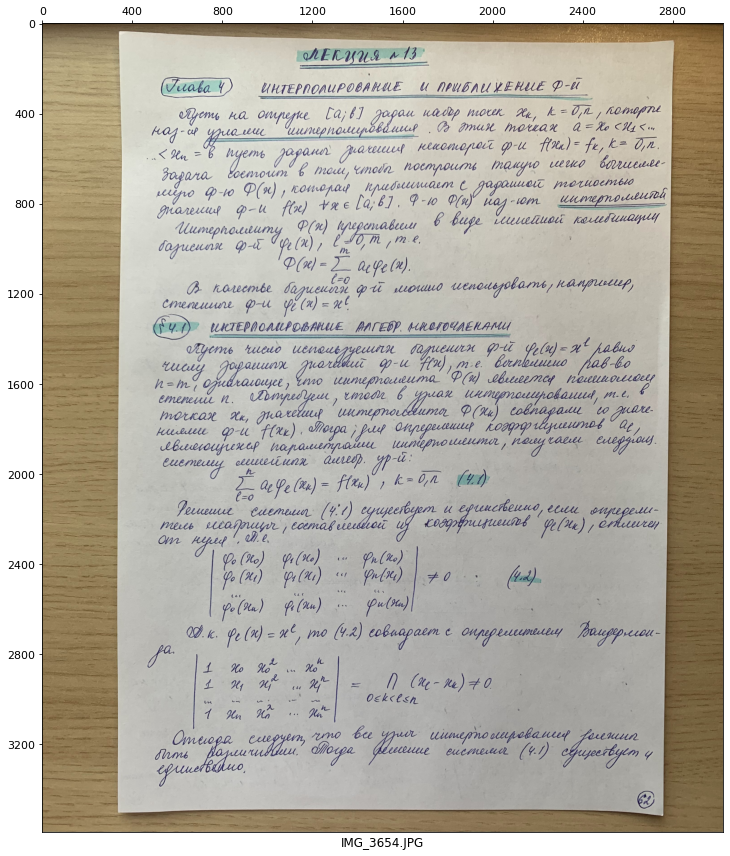

In [29]:
img, name = src_images[0], src_names_arr[0]
show_images([img], [name], factor_r = 12, factor_c = 12)

In [30]:
paper_mask = get_paper_mask(img)

In [31]:
in_points, out_points = get_paper_coords(paper_mask, 7)

In [32]:
img = get_projected_paper(img, in_points, out_points)
img = to_uint8(img)

In [33]:
paper_mask = get_projected_paper(paper_mask, in_points, out_points)
paper_mask = paper_mask > 0

In [34]:
text_mask = get_text_mask(img, paper_mask)

In [35]:
bg = get_bg(bg_images)
text_mask2 = resize_contain(to_uint8(text_mask), bg.shape[:2]) > 0
bg = crop_by_mask(bg, text_mask2)

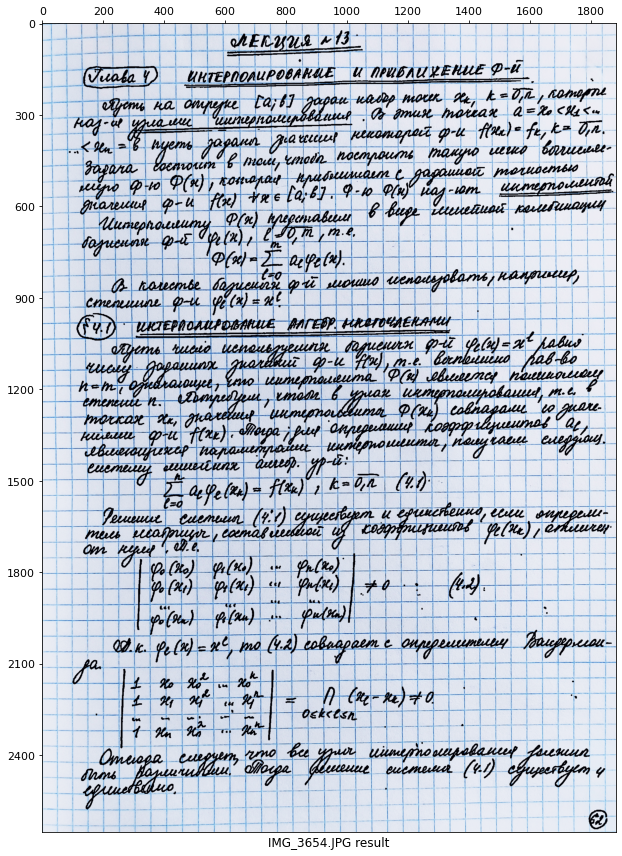

In [36]:
res = color_mask(bg, text_mask2, [0, 0, 50])
res = smooth(res)
show_images([res], [f'{name} result'], factor_r = 12, factor_c = 12)

In [37]:
Image.fromarray(res).save(f'{output_folder}/res_{name}')

### Prod

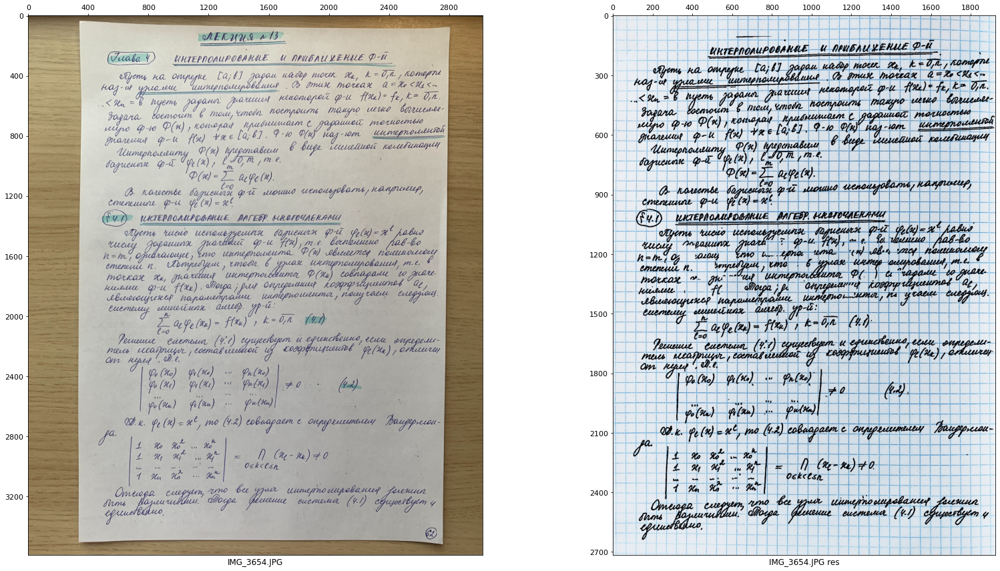

In [170]:
img, name = src_images[0], src_names_arr[0]

res = get_conspect(img, bg_images)

show_images([img, res], [name, f'{name} res'], factor_r = 12, factor_c = 12)

In [96]:
Image.fromarray(res).save(f'{output_folder}/res_{name}')

### RESULT:

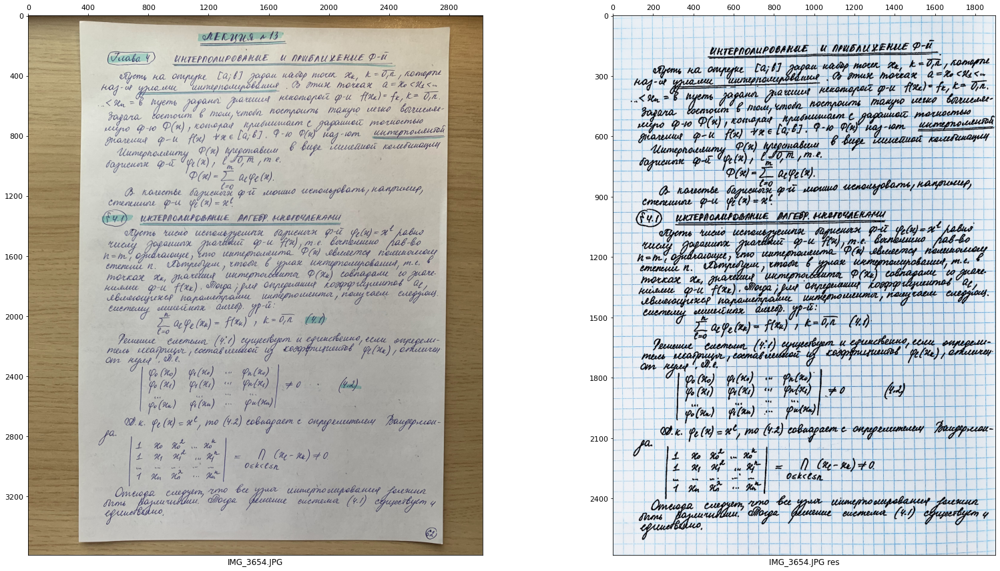

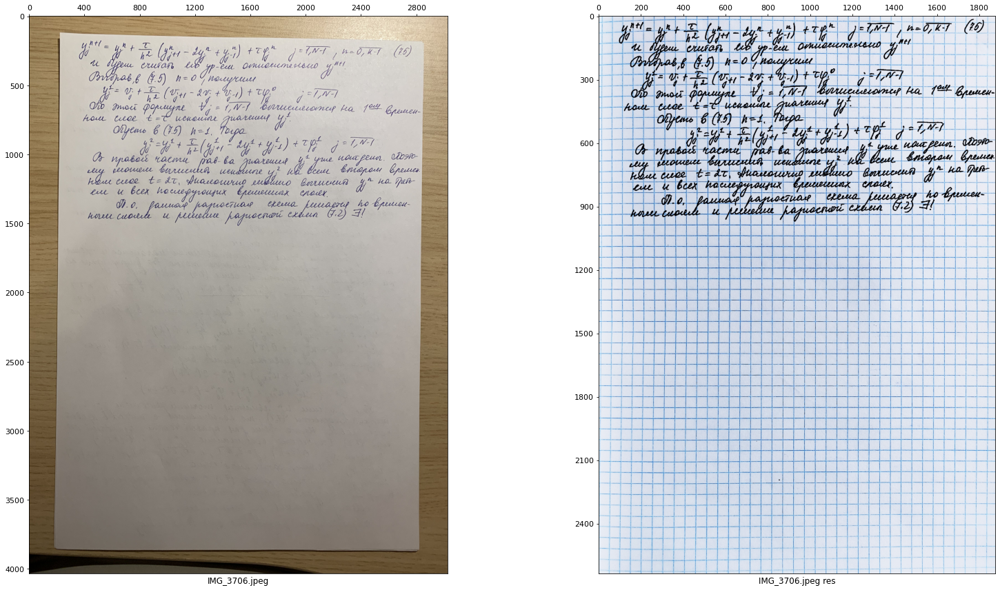

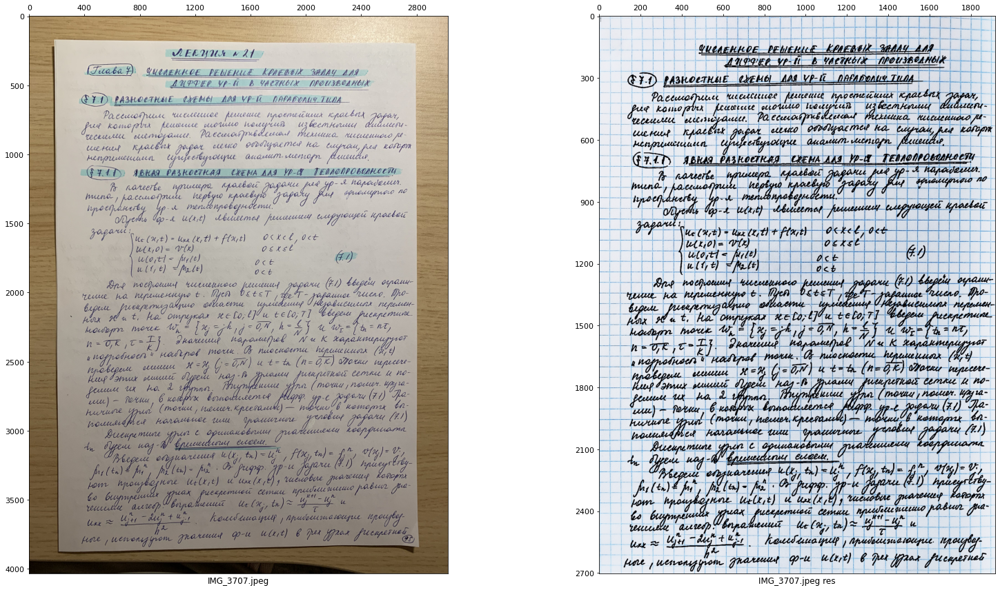

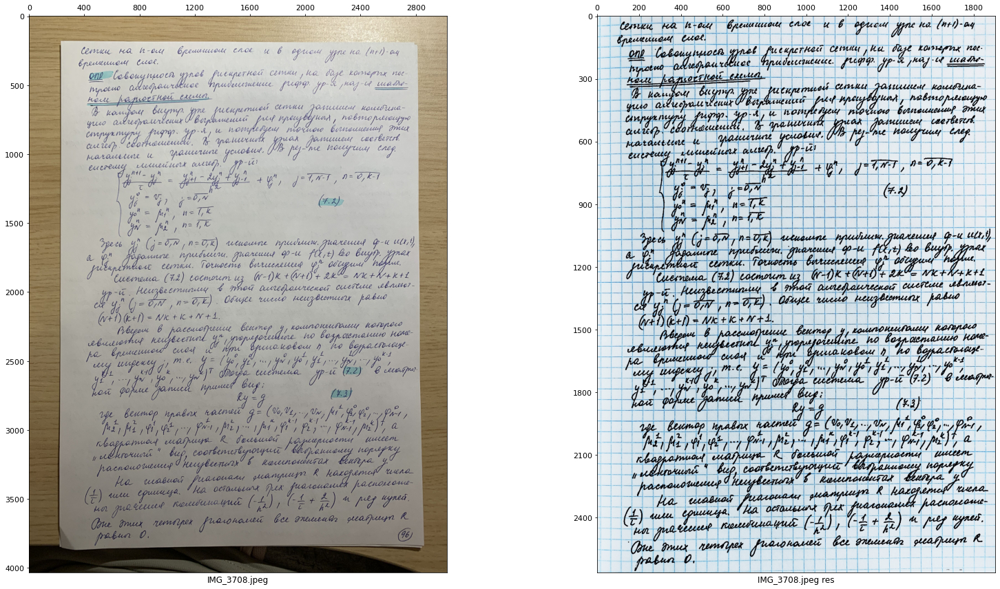

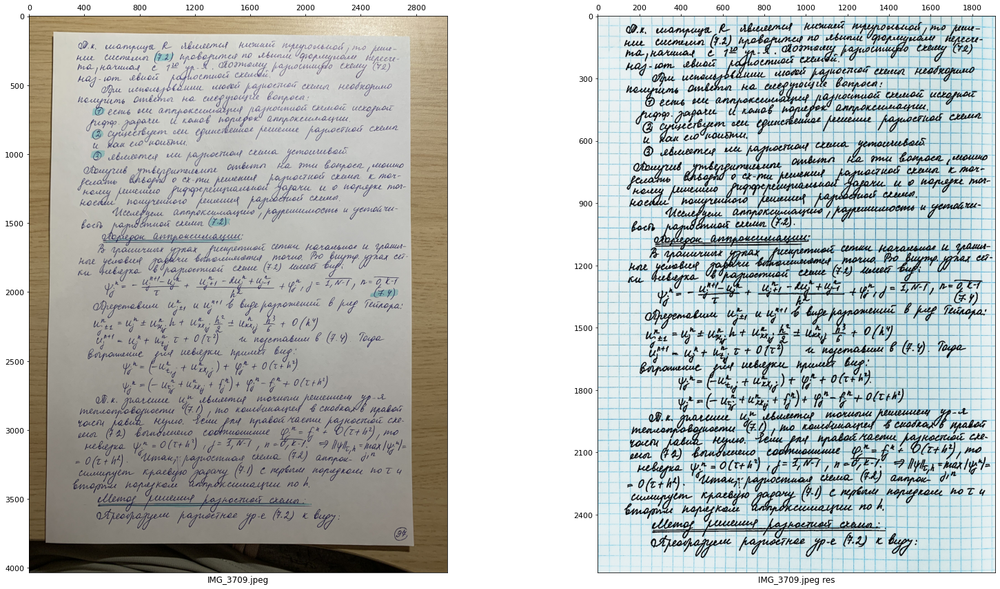

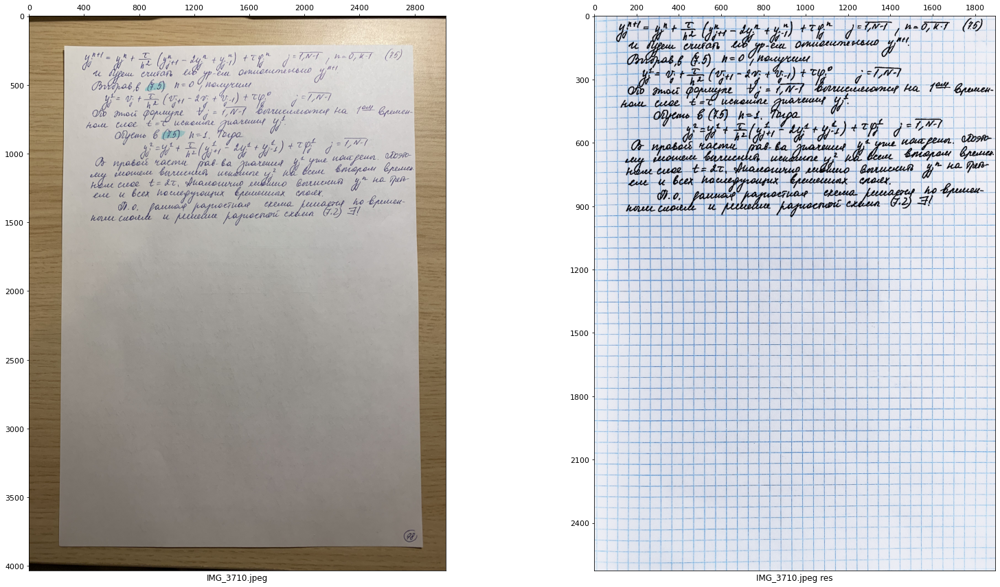

In [38]:
for img, name in zip(src_images, src_names_arr):
    res = get_conspect(img, bg_images)
    show_images([img, res], [name, f'{name} res'], factor_r = 12, factor_c = 12)
    Image.fromarray(res).save(f'{output_folder}/res_{name}')

### Signing

In [49]:
img_path = 'res'
names_arr = []
paths_arr = []
images_arr = []
for folder in listdir('res'):
    name = listdir(f'{img_path}/{folder}')[0]
    names_arr.append(name)
    path = f'{img_path}/{folder}/{name}'
    paths_arr.append(path)

    images_arr.append(np.array(Image.open(path)))
names_arr

['res_IMG_3654.JPG',
 'res_IMG_3658.JPG',
 'res_IMG_3662.JPG',
 'res_IMG_3666.JPG',
 'res_IMG_3671.JPG',
 'res_IMG_3675.JPG',
 'res_IMG_3679.JPG',
 'res_IMG_3683.JPG',
 'res_IMG_3707.jpeg']

In [153]:
def add_text(img, text, window_size=800, vis=False):
    img = np.copy(img)
    window_name = 'Select left down corner for text'
    cv2.namedWindow(window_name,cv2.WINDOW_NORMAL)
    cv2.resizeWindow(window_name, shape_under(img, window_size)[::-1])
    r = cv2.selectROI(window_name, img)
    cv2.destroyWindow(window_name)
    if vis:
        area = img[int(r[1]):int(r[1]+r[3]),
               int(r[0]):int(r[0]+r[2])]
        cv2.imshow(f'Area with text', area)
        cv2.waitKey(0)
        cv2.destroyAllWindows()
    coords = [(int(r[0]), int(r[1])), (int(r[0]+r[2]), int(r[1]+r[3]))]
    padding = 10
    # labels settings
    font_scale = 3
    font = cv2.FONT_HERSHEY_COMPLEX
    # labels
    (text_width, text_height) = cv2.getTextSize(text, font, fontScale=font_scale, thickness=1)[0]
    text_offset_x, text_offset_y = np.mean([coords[0], coords[1]], axis=0).astype(np.int)
    box_coords = ((text_offset_x + padding, text_offset_y + padding),
                  (text_offset_x + text_width + padding, text_offset_y - text_height - padding))
    cv2.rectangle(img, box_coords[0], box_coords[1], (255, 255, 255), cv2.FILLED)
    cv2.putText(img, text, (text_offset_x, text_offset_y),
                font, fontScale=font_scale, color=(0, 0, 0), thickness=1)

    return img

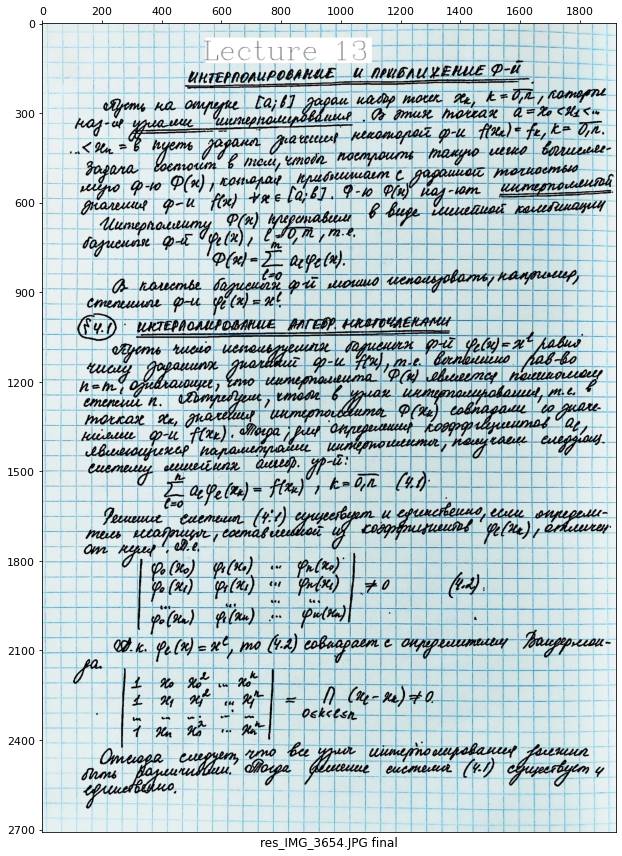

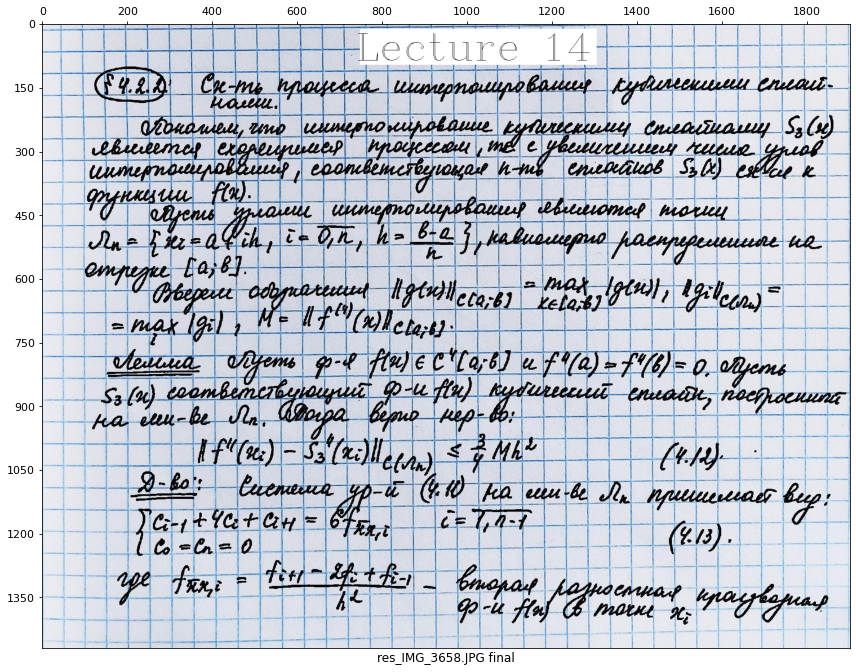

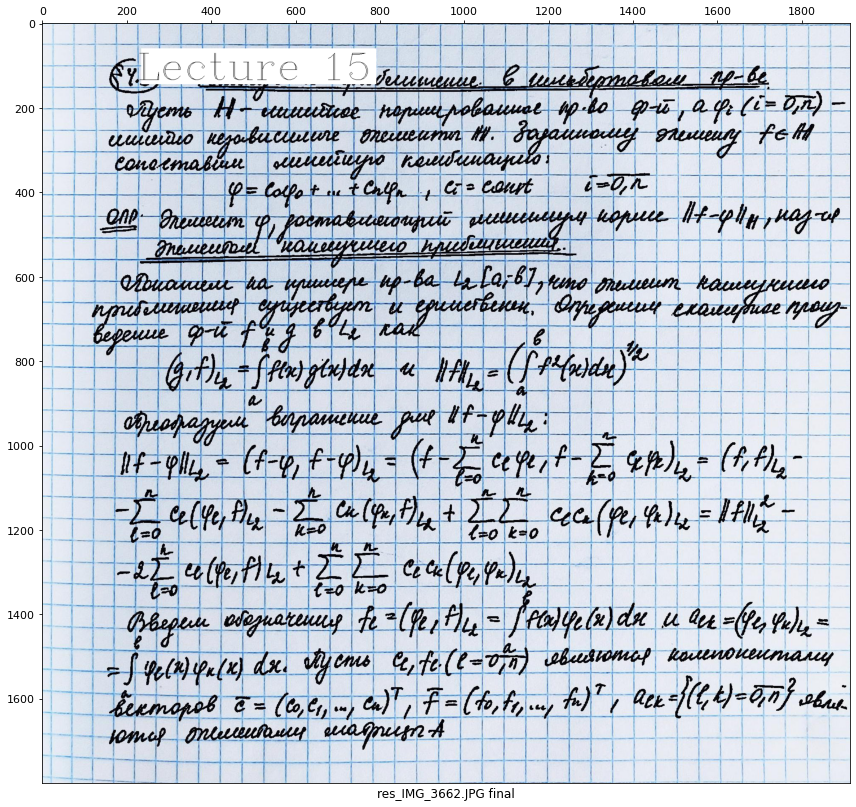

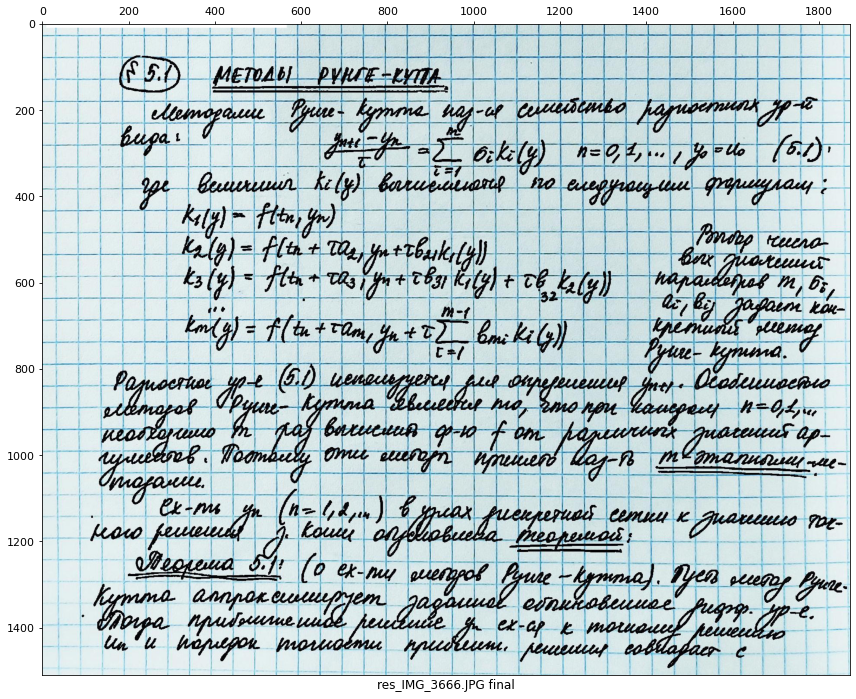

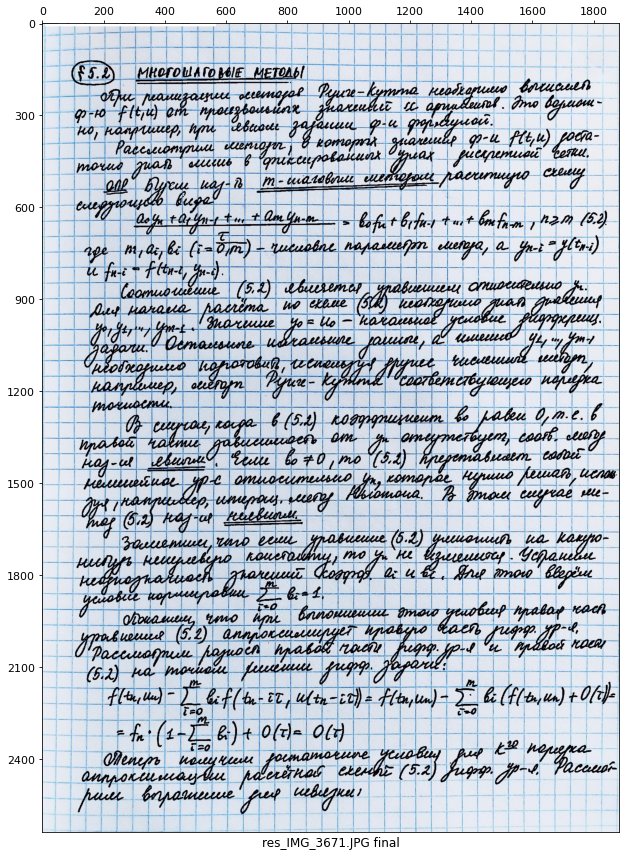

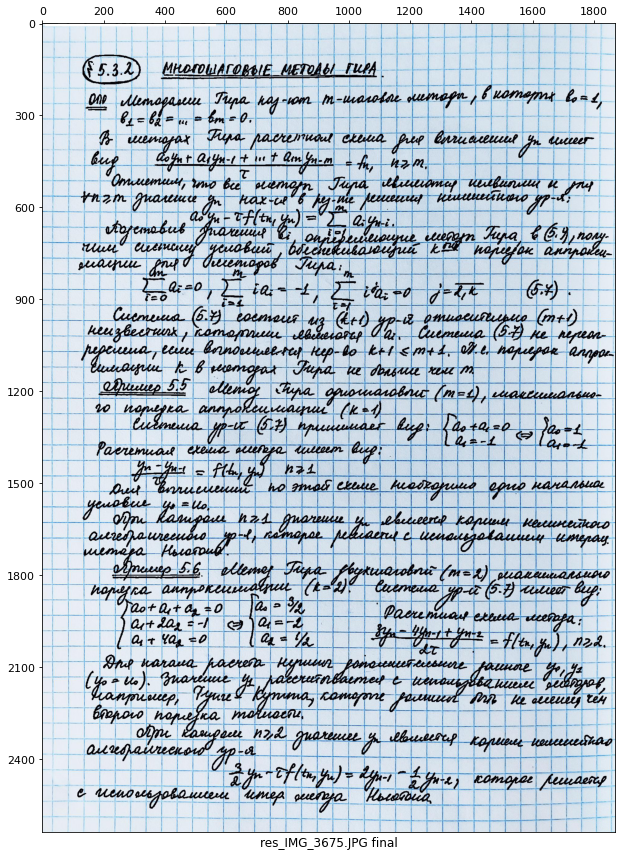

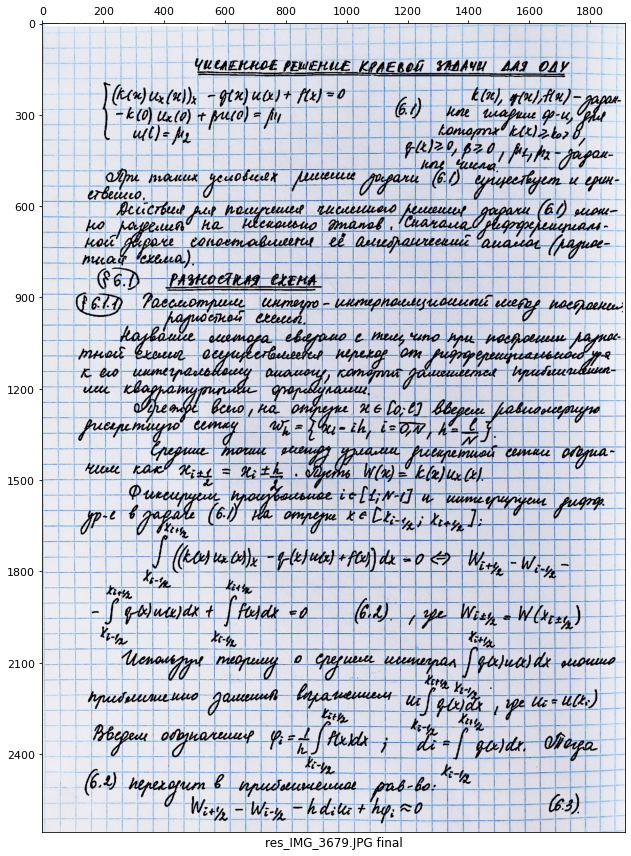

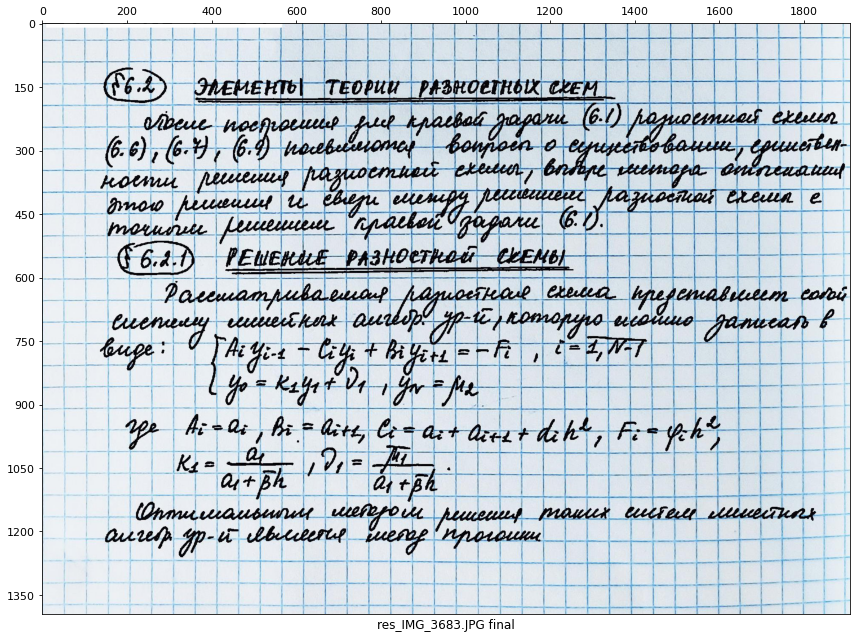

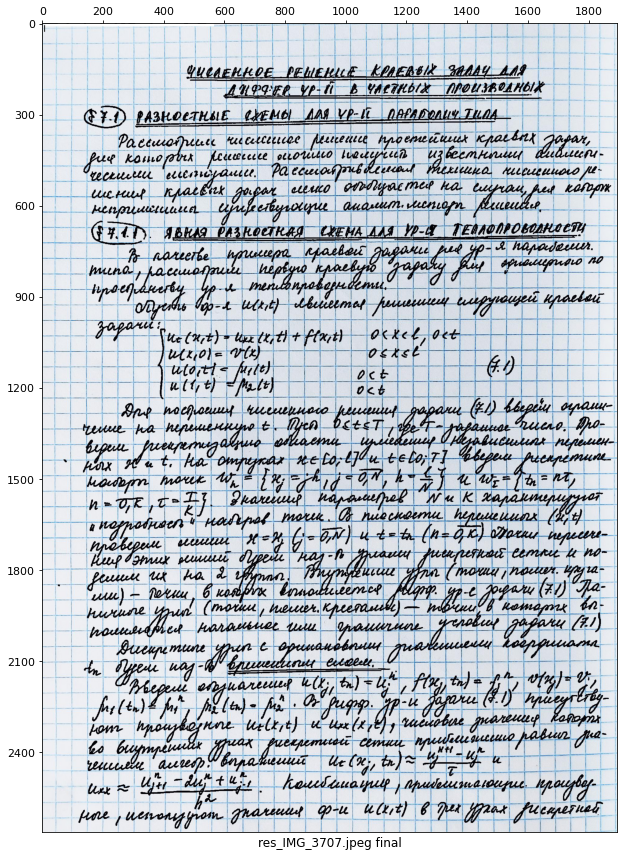

In [167]:
text_arr = [f'Lecture {i}' for i in range(13, 22)]
res_img = []
for i, (name, path, img) in enumerate(zip(names_arr, paths_arr, images_arr)):
    img = add_text(img, text_arr[i])
    show_images([img], [f'{name} final'], factor_r = 12, factor_c = 12)
    res_img.append(img)

In [156]:
for path, img in zip(paths_arr, res_img):
    Image.fromarray(img).save(path)